In [2]:
import pandas as pd

In [47]:
data = pd.read_csv('../data/small_2014-11_key_word.csv',header=None,names=['id','state','text','food','activity','target'],
                  index_col=['id'])

/Users/qintailiu/anaconda3/lib/python3.6/site-packages/numpy/lib/arraysetops.py:472: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [48]:
time_data = pd.read_csv('../data/output_2014-11_id_timestamp_week.csv',header=None,
                       names=['id','timestamp','week'],index_col=['id'])

/Users/qintailiu/anaconda3/lib/python3.6/site-packages/numpy/lib/arraysetops.py:472: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [49]:
final_data = time_data.merge(data,left_index=True,right_index=True)

In [50]:
final_data.to_csv('../data/2014-11_key_work_id_state_time.csv', header=False, index=True)

In [103]:
data_2014_06 = pd.read_csv('../data/2014-06_key_work_id_state_time.csv', header=None,
                  names=['id','timestamp','week','state','text','food','activity','target'],
                  index_col=['id'])
data_2014_11 = pd.read_csv('../data/2014-11_key_work_id_state_time.csv', header=None,
                  names=['id','timestamp','week','state','text','food','activity','target'],
                  index_col=['id'])
data_2015_06 = pd.read_csv('../data/2015-06_key_work_id_state_time.csv', header=None,
                  names=['id','timestamp','week','state','text','food','activity','target'],
                  index_col=['id'])
data_2015_11 = pd.read_csv('../data/2015-11_key_work_id_state_time.csv', header=None,
                  names=['id','timestamp','week','state','text','food','activity','target'],
                  index_col=['id'])

/Users/qintailiu/anaconda3/lib/python3.6/site-packages/numpy/lib/arraysetops.py:472: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [98]:
data.head()

,timestamp,week,state,text,food,activity,target
id,,,,,,,
472890266274496513,1.401595e+09,Sunday,28,an ole miss vs mississippi state super regiona...,NaN,NaN,0
472890267667013632,1.401595e+09,Sunday,36,what be up for tonight a nigga do not wanna st...,NaN,NaN,0
472890268019347458,1.401595e+09,Sunday,42,coulda tell start,NaN,NaN,0
472890268090265600,1.401595e+09,Sunday,27,yo guy knee i ask look realize pray asshole i lol,NaN,NaN,0
472890268119613441,1.401595e+09,Sunday,36,tonight studio 21 dj_mikeneezy live set each,NaN,NaN,0


In [99]:
result = data[['week','target']].groupby('week').count()

In [105]:
def get_frequency(df):
    num1 = sum(df==1)
    num2 = sum(df==2)
    num3 = sum(df==3)
    return pd.DataFrame([[(num1+num3)/len(df),(num2+num3)/len(df)]],columns=['food_freq','activity_freq'])
def cala_fre(data):
    result = data[['week','target']].groupby('week')['target'].apply(get_frequency)
    result.reset_index(level=1,drop=True,inplace=True)
    return result.loc[['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']]

result_2014_06 = cala_fre(data_2014_06)
result_2014_11 = cala_fre(data_2014_11)
result_2015_06 = cala_fre(data_2015_06)
result_2015_11 = cala_fre(data_2015_11)

In [106]:
result_2014_06

,food_freq,activity_freq
week,,
Monday,0.031592,0.049814
Tuesday,0.033779,0.049480
Wednesday,0.033955,0.049687
Thursday,0.033810,0.051246
Friday,0.034642,0.049466
Saturday,0.036082,0.051878
Sunday,0.035650,0.049986


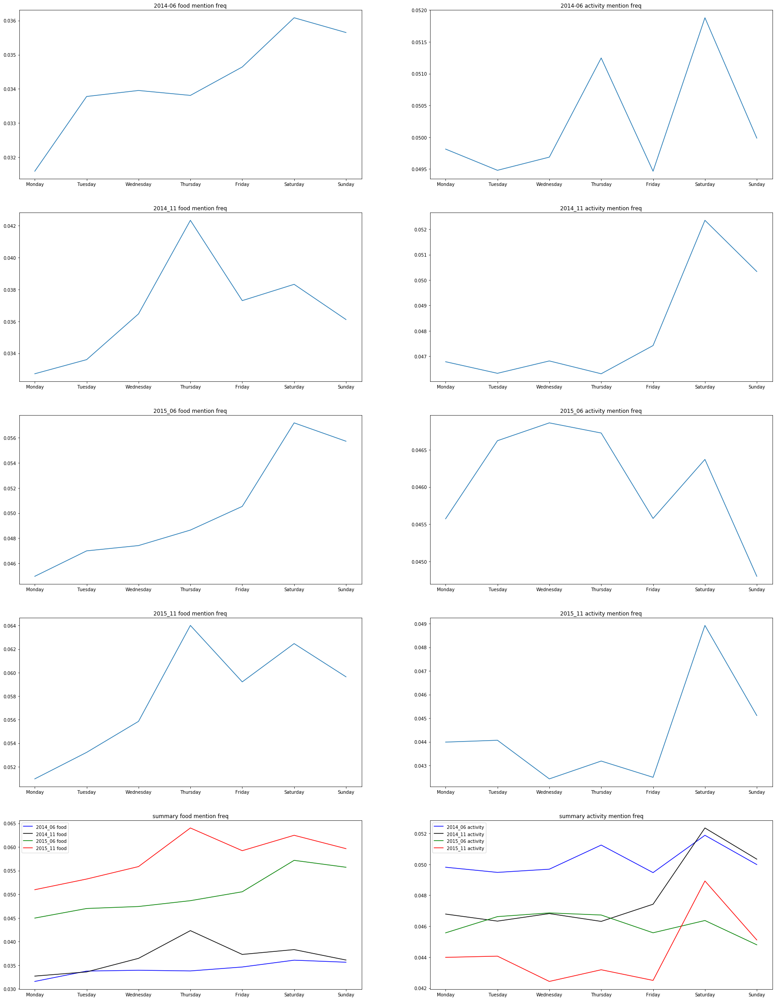

In [142]:
import matplotlib.pyplot as plt
plt.figure(figsize=(30,40))

plt.subplot(5, 2, 1)
plt.plot(result_2014_06['food_freq'].values)
plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
plt.title('2014-06 food mention freq')

plt.subplot(5, 2, 2)
plt.plot(result_2014_06['activity_freq'].values)
plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
plt.title('2014-06 activity mention freq')

plt.subplot(5, 2, 3)
plt.plot(result_2014_11['food_freq'].values)
plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
plt.title('2014_11 food mention freq')

plt.subplot(5, 2, 4)
plt.plot(result_2014_11['activity_freq'].values)
plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
plt.title('2014_11 activity mention freq')

plt.subplot(5, 2, 5)
plt.plot(result_2015_06['food_freq'].values)
plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
plt.title('2015_06 food mention freq')

plt.subplot(5, 2, 6)
plt.plot(result_2015_06['activity_freq'].values)
plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
plt.title('2015_06 activity mention freq')

plt.subplot(5, 2, 7)
plt.plot(result_2015_11['food_freq'].values)
plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
plt.title('2015_11 food mention freq')

plt.subplot(5, 2, 8)
plt.plot(result_2015_11['activity_freq'].values)
plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
plt.title('2015_11 activity mention freq')

plt.subplot(5, 2, 9)
plt.plot(result_2014_06['food_freq'].values, 'blue', label = '2014_06 food')
plt.plot(result_2014_11['food_freq'].values, 'black', label = '2014_11 food')
plt.plot(result_2015_06['food_freq'].values, 'green', label = '2015_06 food')
plt.plot(result_2015_11['food_freq'].values, 'red', label = '2015_11 food')
plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
plt.title('summary food mention freq')
plt.legend()

plt.subplot(5, 2, 10)
plt.plot(result_2014_06['activity_freq'].values, 'blue', label = '2014_06 activity')
plt.plot(result_2014_11['activity_freq'].values, 'black', label = '2014_11 activity')
plt.plot(result_2015_06['activity_freq'].values, 'green', label = '2015_06 activity')
plt.plot(result_2015_11['activity_freq'].values, 'red', label = '2015_11 activity')
plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
plt.title('summary activity mention freq')
plt.legend()


plt.savefig('../data/figure_food_activity_mention_freq/test.png')

In [144]:
state_data = pd.read_csv('../data/state.csv', names=['state_id','state','state_name','a'],
                         usecols=['state_id','state','state_name'],
                         index_col=['state_id'],header=None)
state = [1,  4,  5,  6,  8,  9, 10, 11, 12, 13, 16, 17, 18, 19, 20, 21, 22,
       23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39,
       40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 53, 54, 55, 56]    
state_data = state_data.loc[state]


In [153]:
def cala_freq_state(data):
    result = data[['week','state','target']].groupby(['state','week'])['target'].apply(get_frequency)
    result.reset_index(level=2,drop=True,inplace=True)
    return result

total_data = [data_2014_06, data_2014_11, data_2015_06, data_2015_11]
total_result = []
for data in total_data:
    total_result.append(cala_freq_state(data))

In [154]:
result = total_result[0]

In [155]:
result_2014_06

,food_freq,activity_freq
week,,
Monday,0.031592,0.049814
Tuesday,0.033779,0.049480
Wednesday,0.033955,0.049687
Thursday,0.033810,0.051246
Friday,0.034642,0.049466
Saturday,0.036082,0.051878
Sunday,0.035650,0.049986


In [163]:
current_state_index = 9
current_state_name = state_data.loc[current_state_index]['state_name']
result.loc[current_state_index]

,food_freq,activity_freq
week,,
Friday,0.033945,0.048180
Monday,0.029803,0.049259
Saturday,0.034894,0.050285
Sunday,0.034713,0.049625
Thursday,0.032321,0.048921
Tuesday,0.030768,0.048017
Wednesday,0.034011,0.046826


In [172]:
def show_state_freq(current_state_index):
    
    current_state_name = state_data.loc[current_state_index]['state_name']
    result.loc[current_state_index]


    plt.figure(figsize=(30,40))

    plt.subplot(5, 2, 1)
    plt.plot(total_result[0].loc[current_state_index]['food_freq'].values, 'blue', label = current_state_name)
    plt.plot(result_2014_06['food_freq'].values, 'black', label = 'overall')
    plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
    plt.title('2014-06 food mention freq')
    plt.legend()

    plt.subplot(5, 2, 2)
    plt.plot(total_result[0].loc[current_state_index]['activity_freq'].values, 'blue', label = current_state_name)
    plt.plot(result_2014_06['activity_freq'].values, 'black', label = 'overall')
    plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
    plt.title('2014-06 activity mention freq')
    plt.legend()

    plt.subplot(5, 2, 3)
    plt.plot(total_result[1].loc[current_state_index]['food_freq'].values, 'blue', label = current_state_name)
    plt.plot(result_2014_11['food_freq'].values, 'black', label = 'overall')
    plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
    plt.title('2014_11 food mention freq')
    plt.legend()

    plt.subplot(5, 2, 4)
    plt.plot(total_result[1].loc[current_state_index]['activity_freq'].values, 'blue', label = current_state_name)
    plt.plot(result_2014_11['activity_freq'].values, 'black', label = 'overall')
    plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
    plt.title('2014_11 activity mention freq')
    plt.legend()

    plt.subplot(5, 2, 5)
    plt.plot(total_result[2].loc[current_state_index]['food_freq'].values, 'blue', label = current_state_name)
    plt.plot(result_2015_06['food_freq'].values, 'black', label = 'overall')
    plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
    plt.title('2015_06 food mention freq')
    plt.legend()

    plt.subplot(5, 2, 6)
    plt.plot(total_result[2].loc[current_state_index]['activity_freq'].values, 'blue', label = current_state_name)
    plt.plot(result_2015_06['activity_freq'].values, 'black', label = 'overall')
    plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
    plt.title('2015_06 activity mention freq')
    plt.legend()

    plt.subplot(5, 2, 7)
    plt.plot(total_result[3].loc[current_state_index]['food_freq'].values, 'blue', label = current_state_name)
    plt.plot(result_2015_11['food_freq'].values, 'black', label = 'overall')
    plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
    plt.title('2015_11 food mention freq')
    plt.legend()

    plt.subplot(5, 2, 8)
    plt.plot(total_result[3].loc[current_state_index]['activity_freq'].values, 'blue', label = current_state_name)
    plt.plot(result_2015_11['activity_freq'].values, 'black', label = 'overall')
    plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
    plt.title('2015_11 activity mention freq')
    plt.legend()

    plt.subplot(5, 2, 9)
    plt.plot(total_result[0].loc[current_state_index]['food_freq'].values, 'blue', label = '2014_06 food')
    plt.plot(total_result[1].loc[current_state_index]['food_freq'].values, 'black', label = '2014_11 food')
    plt.plot(total_result[2].loc[current_state_index]['food_freq'].values, 'green', label = '2015_06 food')
    plt.plot(total_result[3].loc[current_state_index]['food_freq'].values, 'red', label = '2015_11 food')
    plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
    plt.title('summary food mention freq')
    plt.legend()

    plt.subplot(5, 2, 10)
    plt.plot(total_result[0].loc[current_state_index]['activity_freq'].values, 'blue', label = '2014_06 activity')
    plt.plot(total_result[1].loc[current_state_index]['activity_freq'].values, 'black', label = '2014_11 activity')
    plt.plot(total_result[2].loc[current_state_index]['activity_freq'].values, 'green', label = '2015_06 activity')
    plt.plot(total_result[3].loc[current_state_index]['activity_freq'].values, 'red', label = '2015_11 activity')
    plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
    plt.title('summary activity mention freq')
    plt.legend()


    plt.savefig('../data/figure_food_activity_mention_freq/'+current_state_name+'.png')

/Users/qintailiu/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


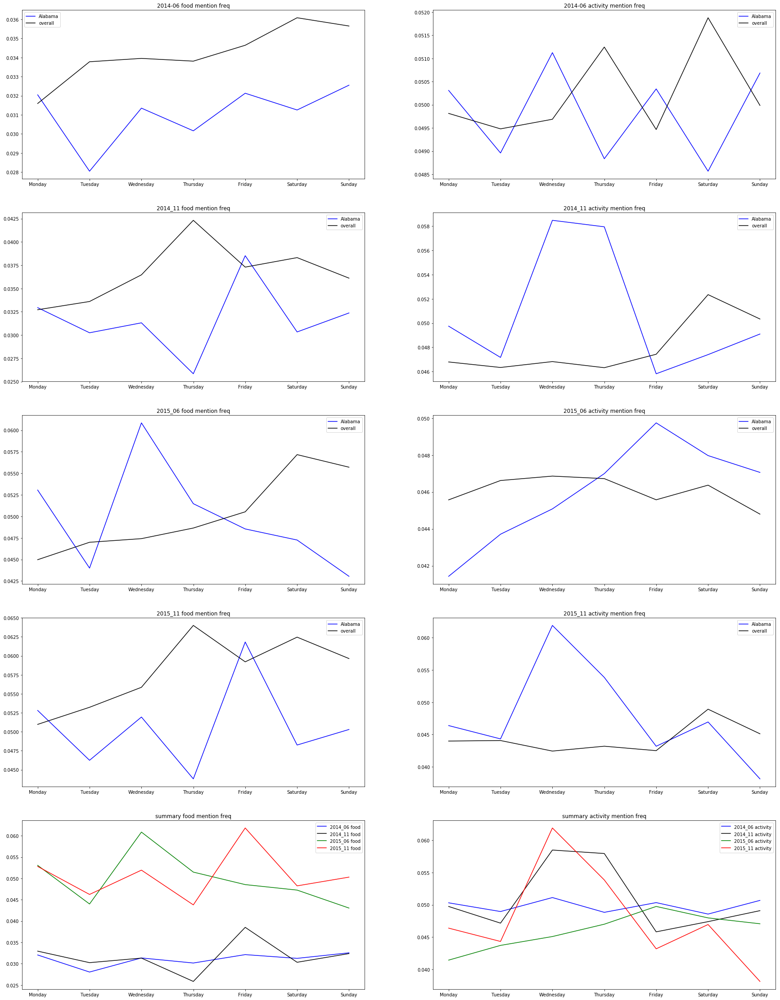

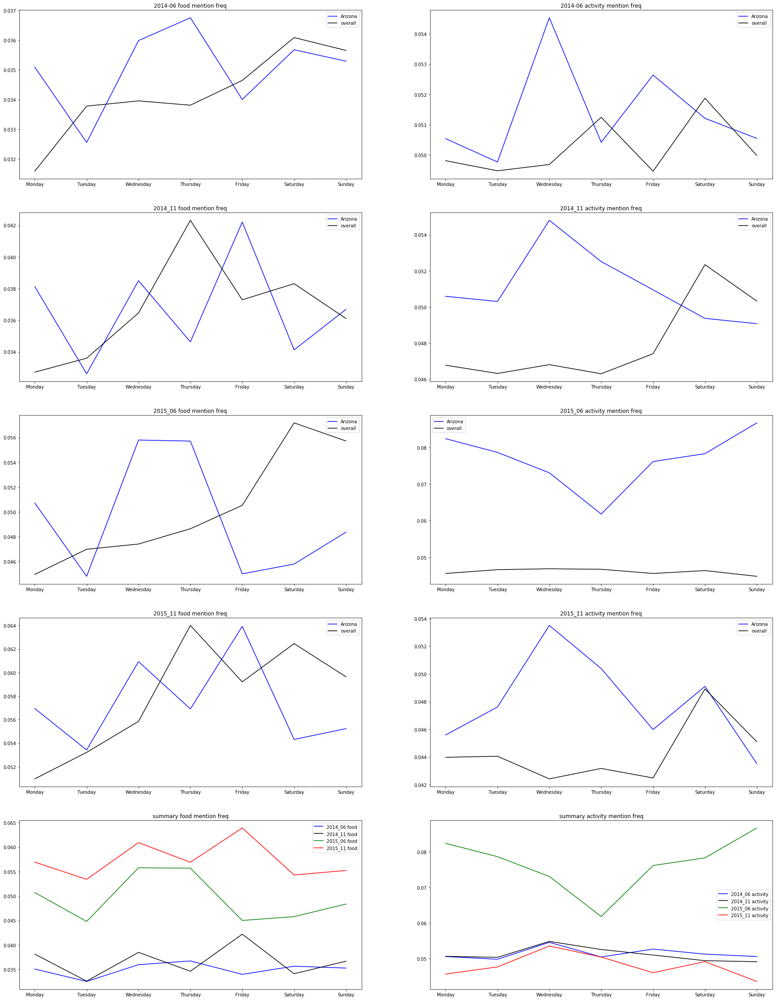

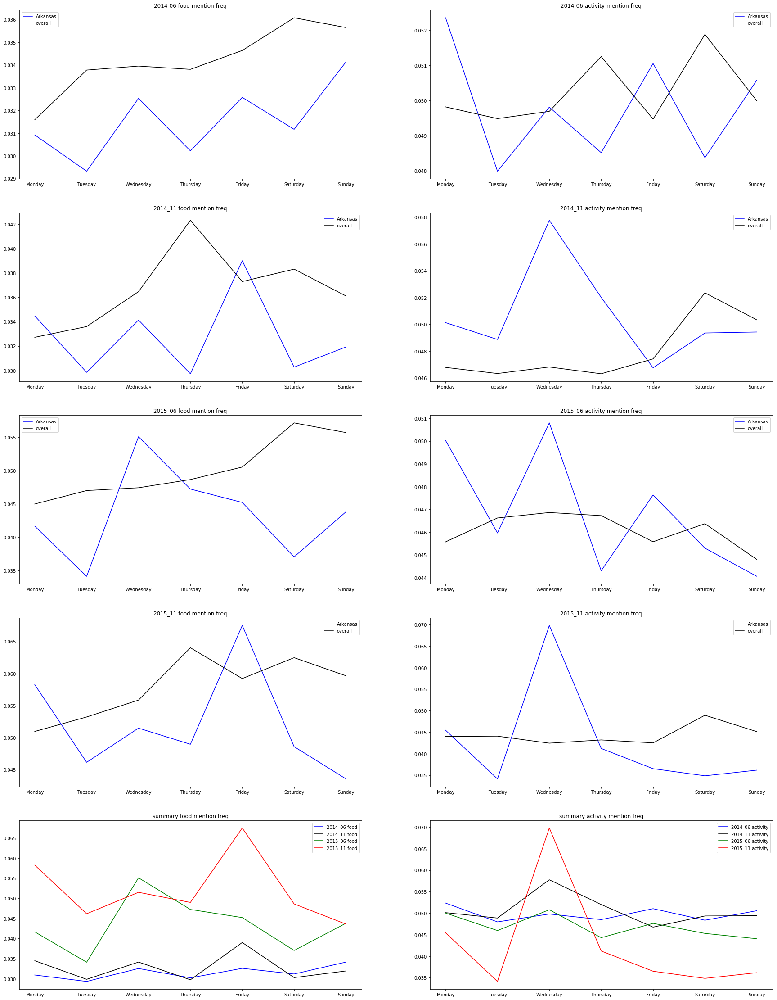

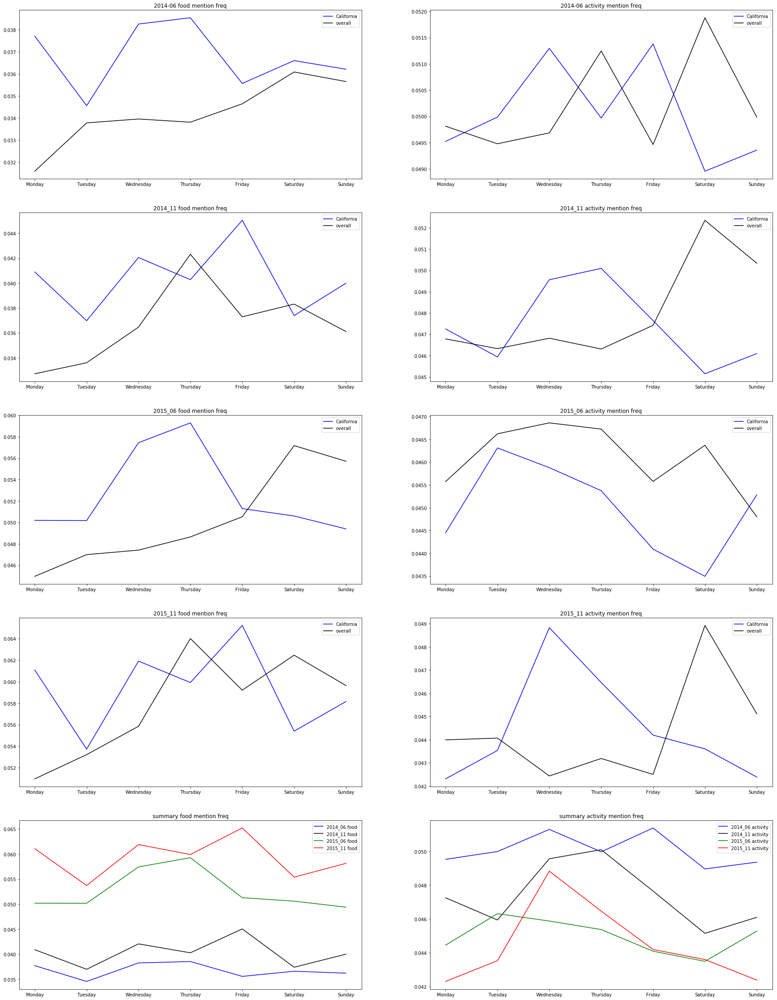

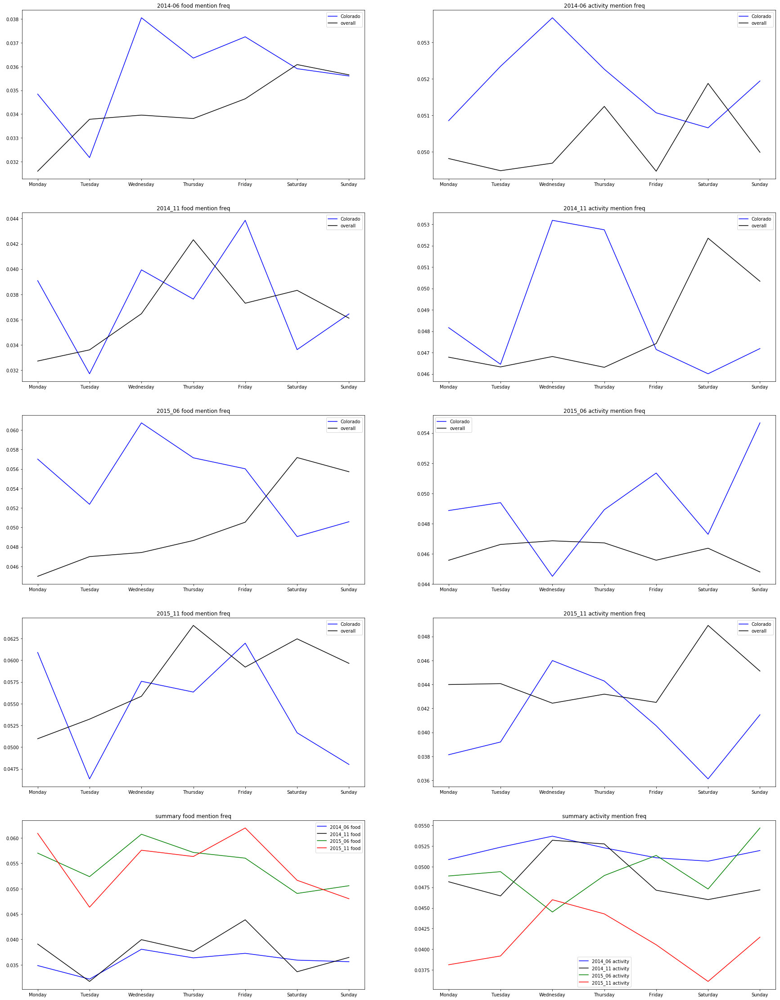

...

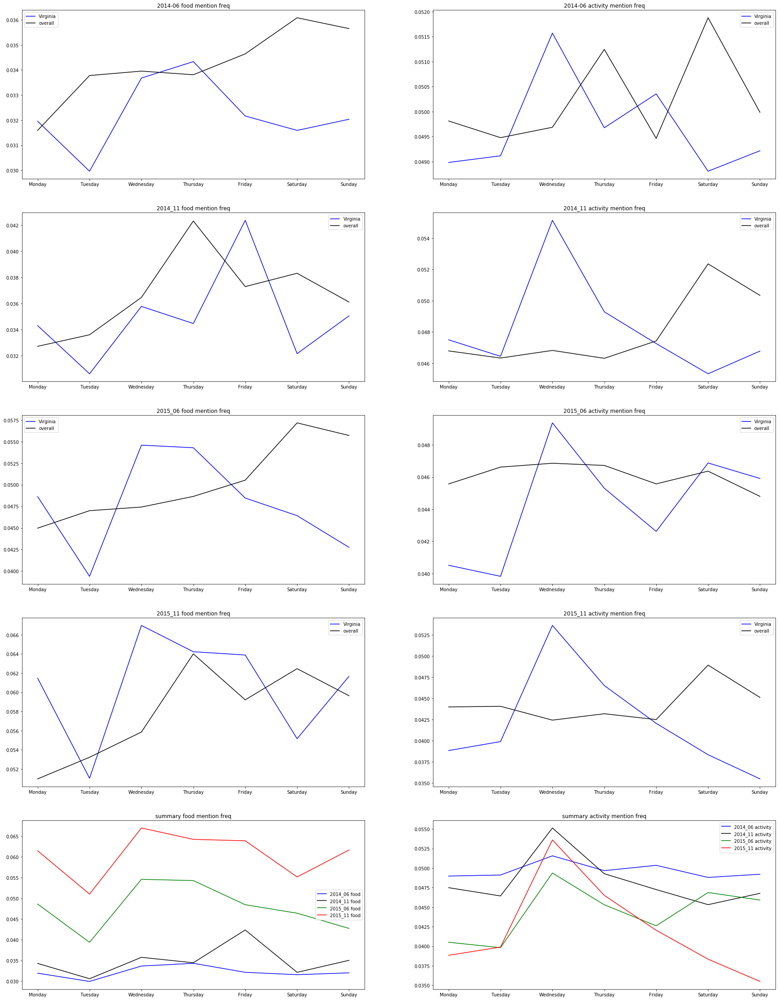

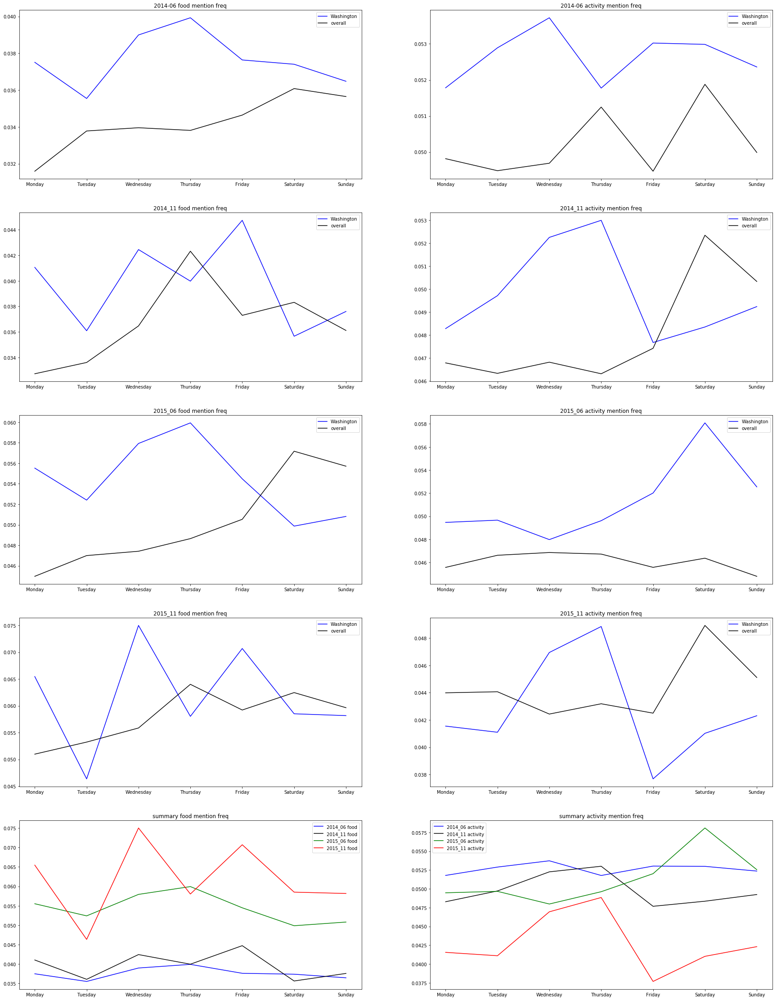

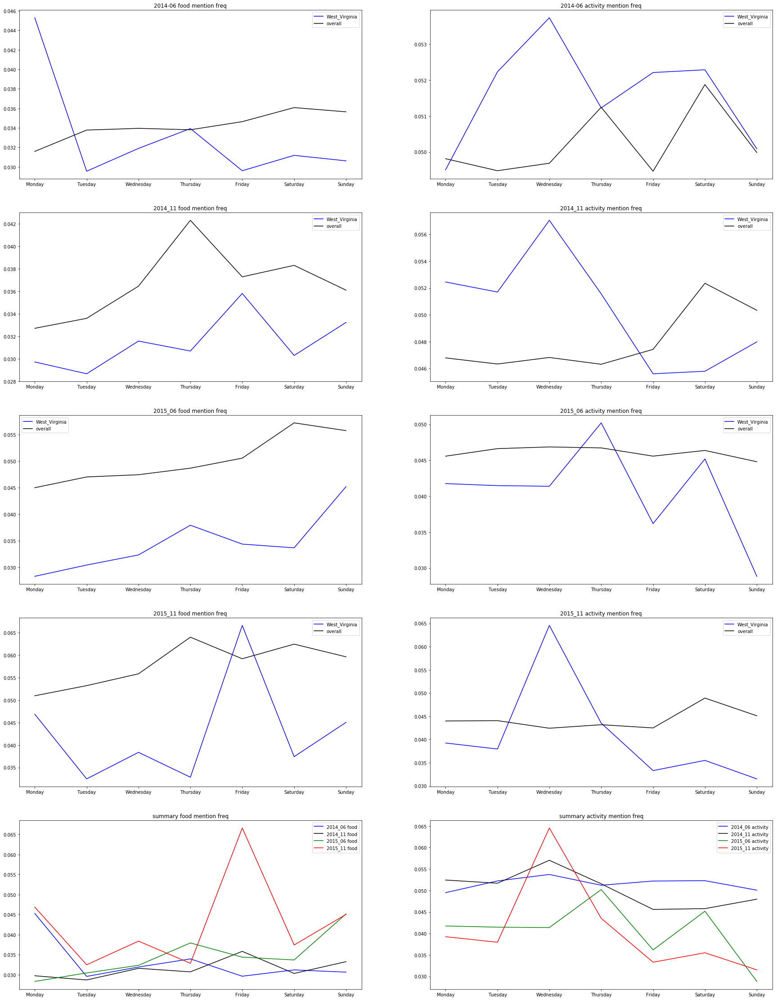

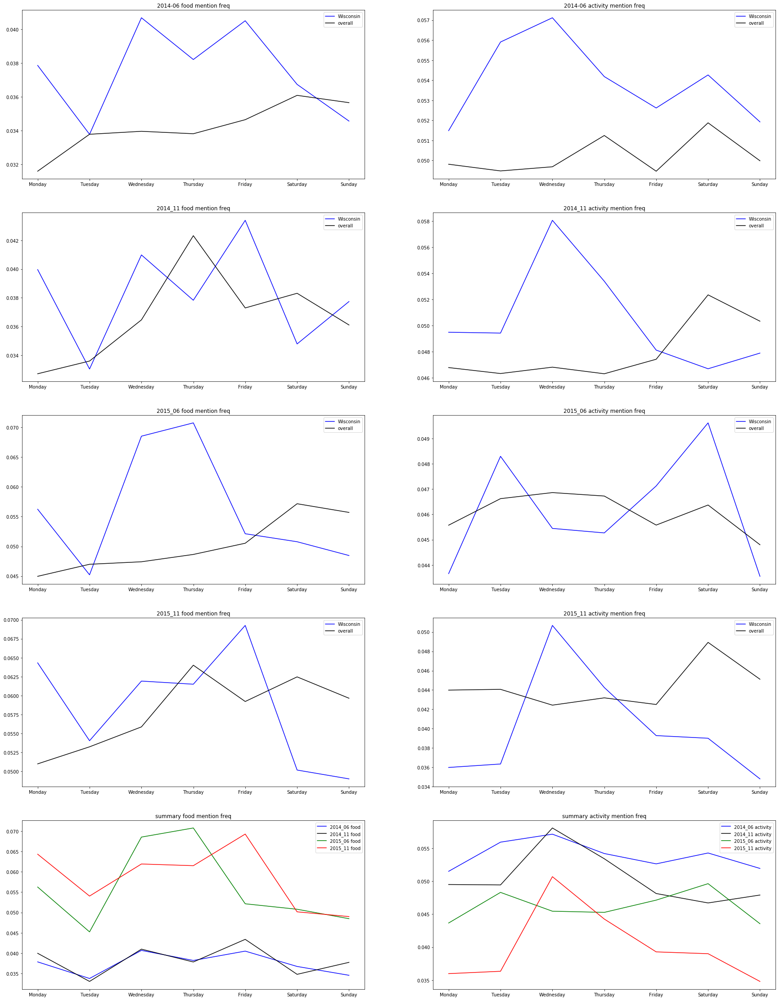

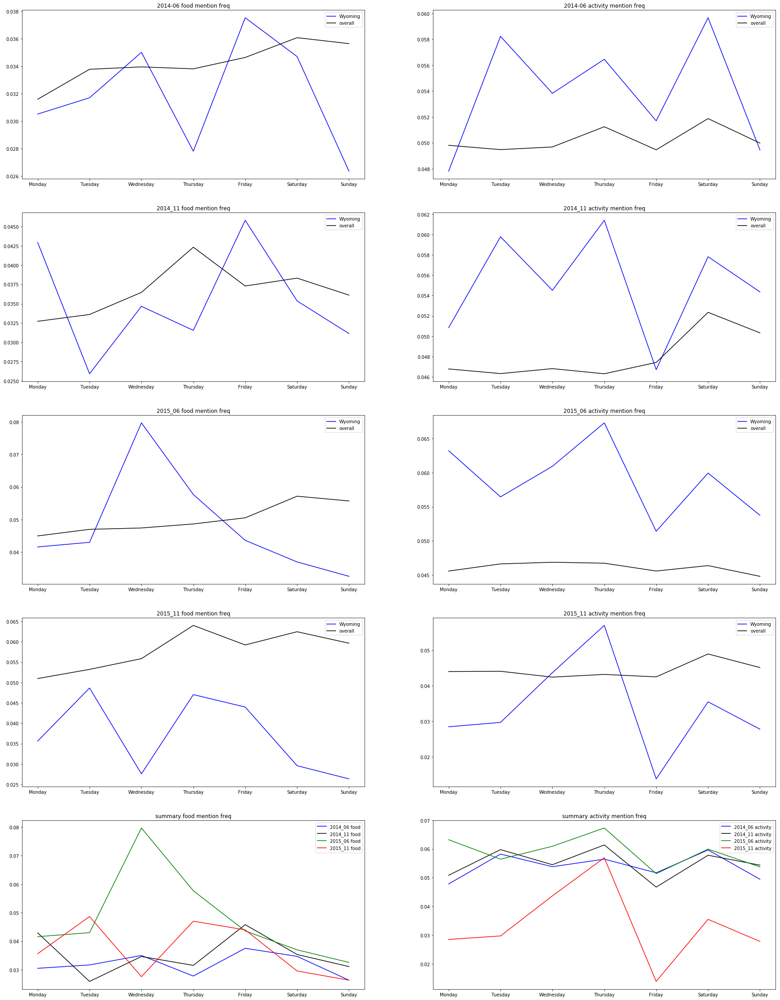

In [173]:
for state_index in state:
    show_state_freq(state_index)

Text(0.5,1,'2014-06 food mention freq')

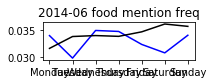

In [169]:
    plt.subplot(5, 2, 1)
    plt.plot(total_result[0].loc[current_state_index]['food_freq'].values, 'blue', label = current_state_name)
    plt.plot(result_2014_06['food_freq'].values, 'black', label = 'overall')
    plt.xticks(range(7), ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
    plt.title('2014-06 food mention freq')